# Clasificador de Grietas mediante Red Neuronal Convolutiva (CNN)

### Trabajo elaborado por:
**Daniel Francisco Calderón Lebrón**  
Estudiante de Ingeniería en Sistemas, 2024-2  
Politécnico Colombiano Jaime Isaza Cadavid  

---

## Descripción del Proyecto

Este proyecto tiene como objetivo el desarrollo de un clasificador de grietas en concreto utilizando una Red Neuronal Convolutiva (CNN). Las imágenes de concreto son procesadas por la red neuronal para determinar si contienen grietas o no. Este sistema es fundamental en la inspección automatizada de infraestructuras, proporcionando una herramienta eficiente para detectar daños estructurales.

### Tecnologías Utilizadas:
- **TensorFlow**: Para la creación y entrenamiento de la red neuronal convolutiva.
- **OpenCV**: Para el procesamiento de imágenes.
- **Python**: Lenguaje de programación principal.
- **Keras**: Framework para construir redes neuronales.

---

## Objetivos
- Desarrollar un modelo de red neuronal convolutiva capaz de detectar grietas en imágenes de concreto.
- Evaluar la precisión del modelo mediante métricas como la precisión, recall, F1-score y la matriz de confusión.
- Implementar el sistema para clasificación binaria (con grieta / sin grieta) con alto rendimiento y precisión.

---

## Resultados Esperados
- Un clasificador entrenado con imágenes de grietas en concreto que sea capaz de identificar correctamente las grietas en nuevas imágenes.
- Mejoras en la detección de daños estructurales para su implementación en proyectos de inspección automatizada.

---

## Contacto
- **Email**: daniel_calderon91151@elpoli.edu.co  
- **GitHub**: [@Daniel-Francisco-Calderon-Lebro](https://github.com/Daniel-Francisco-Calderon-Lebro/Vision_por_Computador_con_IA)


### Librerias Implementadas

In [1]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Activation
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import pickle
import numpy as np
import cv2
import os
import random
import matplotlib.pyplot as plt


### Especificación de las carpetas

In [2]:
base_path = r'C:\Users\Daniel Calderon\Desktop\2024-2 Poli\Vision Con IA\Practica5_(ParcialFinal)\Base_datos'
folder = '\Grietas_NoGrietas'
sub_folders = ['\Con_Grietas', '\Sin_Grietas']

### Adquisión de Datos

In [3]:
data = []
labels = []
for subfolder in sub_folders:
    files = [f for f in os.listdir(base_path + folder + subfolder) if f.endswith('.jpg')]
    for file in files:
        img = cv2.imread(base_path + folder + subfolder + '/' + file, cv2.IMREAD_COLOR)
        img = cv2.resize(img, (128, 128))
        img = img.astype('float32') / 255.0
        data.append(img)
        labels.append(subfolder)

### Procesamiento de etiquetas


In [4]:
lb = LabelBinarizer()
labels = lb.fit_transform(labels).flatten()
print(labels)

[0 0 0 ... 1 1 1]


### Implementación de train_test_split

In [5]:
(trainX, testX, trainY, testY) = train_test_split(np.array(data), np.array(labels), test_size=0.25)

### Definición del modelo

In [11]:
model = Sequential()
model.add(Conv2D(32, (3, 3), padding="same", input_shape=(128, 128, 3)))
model.add(Activation("relu"))
model.add(MaxPooling2D(pool_size=(4, 4), strides=(4, 4)))

model.add(Conv2D(64, (3, 3), padding="same"))
model.add(Activation("relu"))
model.add(MaxPooling2D(pool_size=(4, 4), strides=(4, 4)))

# model.add(Conv2D(64, (3, 3), padding="same"))
# model.add(Activation("relu"))
# model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

model.add(Flatten())
model.add(Dense(1024))
model.add(Activation("relu"))

# Salida binaria
model.add(Dense(1))
model.add(Activation("sigmoid"))

model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_11 (Conv2D)           (None, 128, 128, 32)      896       
_________________________________________________________________
activation_21 (Activation)   (None, 128, 128, 32)      0         
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 32, 32, 32)        0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 32, 32, 64)        18496     
_________________________________________________________________
activation_22 (Activation)   (None, 32, 32, 64)        0         
_________________________________________________________________
max_pooling2d_12 (MaxPooling (None, 8, 8, 64)          0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 4096)             

### Compilación y entrenamiento

In [12]:
opt = RMSprop(learning_rate=0.0001, decay=1e-6)
model.compile(loss="binary_crossentropy", optimizer=opt, metrics=["accuracy"])
# H = model.fit(trainX, trainY, validation_data=(testX, testY), epochs=10, batch_size=32)
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Entrenamiento con early stopping
H = model.fit(trainX, trainY, validation_data=(testX, testY), 
              epochs=15, batch_size=32, callbacks=[early_stopping])

Epoch 1/15
938/938 [==============================] - 156s 166ms/step - loss: 0.1312 - accuracy: 0.9557 - val_loss: 0.1002 - val_accuracy: 0.9637
Epoch 2/15
938/938 [==============================] - 154s 164ms/step - loss: 0.0543 - accuracy: 0.9830 - val_loss: 0.0404 - val_accuracy: 0.9879
Epoch 3/15
938/938 [==============================] - 149s 159ms/step - loss: 0.0411 - accuracy: 0.9877 - val_loss: 0.0369 - val_accuracy: 0.9877
Epoch 4/15
938/938 [==============================] - 147s 157ms/step - loss: 0.0321 - accuracy: 0.9906 - val_loss: 0.0242 - val_accuracy: 0.9926
Epoch 5/15
938/938 [==============================] - 150s 160ms/step - loss: 0.0282 - accuracy: 0.9914 - val_loss: 0.0212 - val_accuracy: 0.9930
Epoch 6/15
938/938 [==============================] - 152s 162ms/step - loss: 0.0234 - accuracy: 0.9932 - val_loss: 0.0174 - val_accuracy: 0.9943
Epoch 7/15
938/938 [==============================] - 151s 161ms/step - loss: 0.0213 - accuracy: 0.9935 - val_loss: 0.0186 -

## Explicación de los Parámetros en `EarlyStopping`

### 📌 `monitor='val_loss'`

- Este parámetro define la métrica que el callback observará para decidir si el entrenamiento debe detenerse. En este caso, se está monitoreando `val_loss`, que representa la **pérdida en los datos de validación**.
- Cuando `val_loss` deje de mejorar (es decir, cuando no se reduzca más) durante varias épocas consecutivas, se activará el `EarlyStopping`.
- Puedes monitorear otras métricas, como `val_accuracy` o `accuracy`, si prefieres detener el entrenamiento cuando la precisión deja de mejorar.

```python
monitor='val_loss'


### Predicciones y reporte

In [16]:
predictions = (model.predict(testX) > 0.5).astype("int32")
print(classification_report(testY, predictions, target_names=['Sin Grieta', 'Con Grieta']))

              precision    recall  f1-score   support

  Sin Grieta       0.99      1.00      1.00      5015
  Con Grieta       1.00      0.99      1.00      4985

    accuracy                           1.00     10000
   macro avg       1.00      1.00      1.00     10000
weighted avg       1.00      1.00      1.00     10000



### Guardar el modelo completo (arquitectura, pesos y configuración)

In [14]:
model.save('CrackDetector2.h5')

### Guardar la historia en un archivo

In [17]:
with open('historia_entrenamiento.pkl', 'wb') as f:
    pickle.dump(H.history, f)

### Graficar y guardar la pérdida

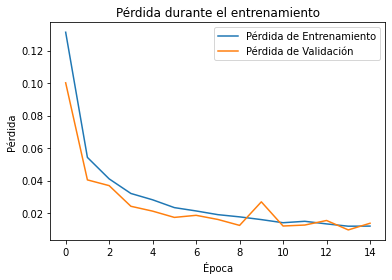

In [18]:
plt.plot(H.history['loss'], label='Pérdida de Entrenamiento')
plt.plot(H.history['val_loss'], label='Pérdida de Validación')
plt.title('Pérdida durante el entrenamiento')
plt.xlabel('Época')
plt.ylabel('Pérdida')
plt.legend()
plt.savefig('grafica_perdida.png')



### Graficar y guardar la precisión

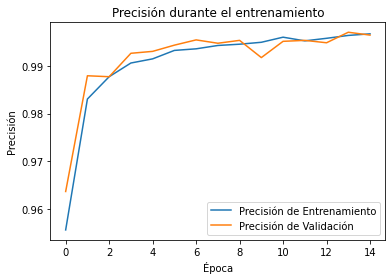

In [19]:
plt.plot(H.history['accuracy'], label='Precisión de Entrenamiento')
plt.plot(H.history['val_accuracy'], label='Precisión de Validación')
plt.title('Precisión durante el entrenamiento')
plt.xlabel('Época')
plt.ylabel('Precisión')
plt.legend()
plt.savefig('grafica_precision.png')

### Bucle para mostrar 400 imágenes aleatorias con sus predicciones

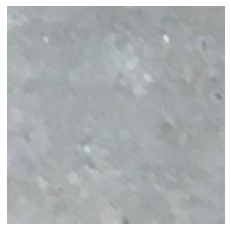

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


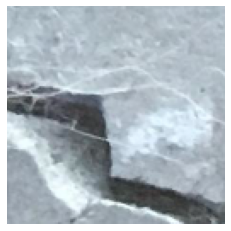

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


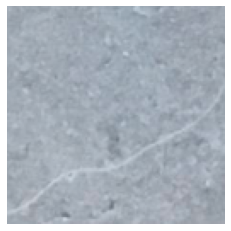

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


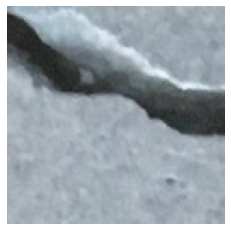

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


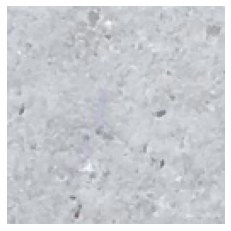

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


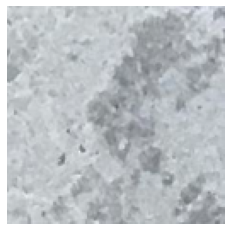

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


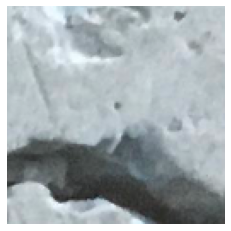

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


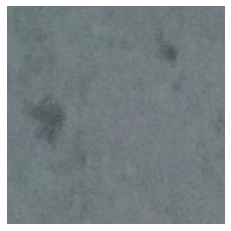

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


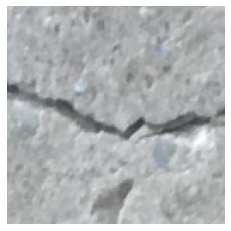

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


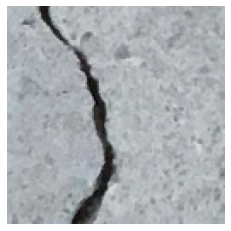

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


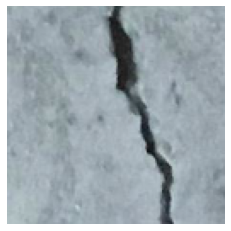

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


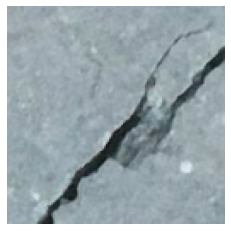

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


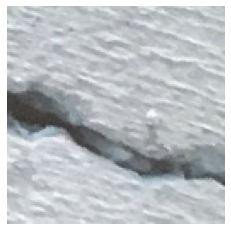

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


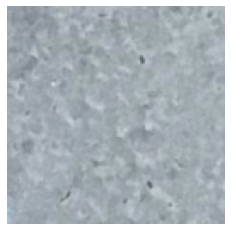

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


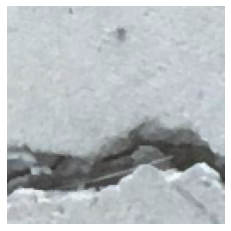

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


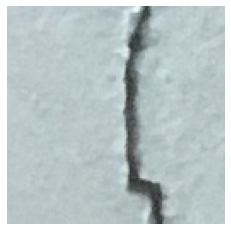

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


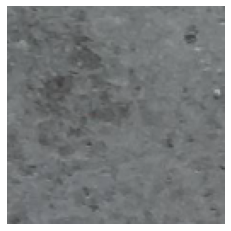

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


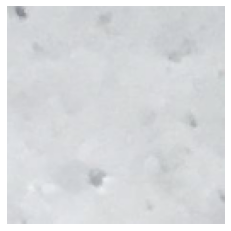

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


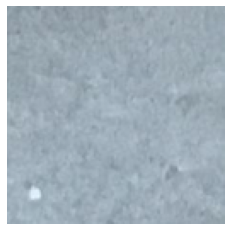

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


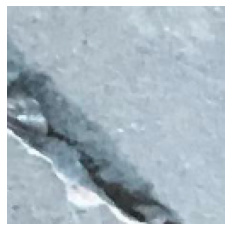

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


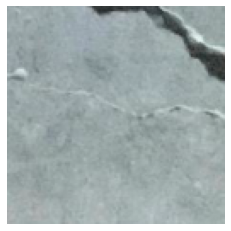

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


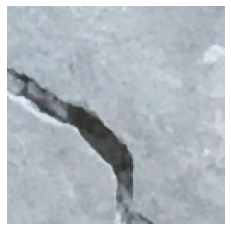

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


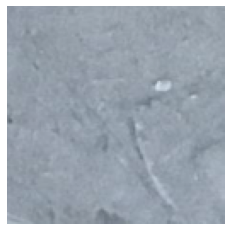

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


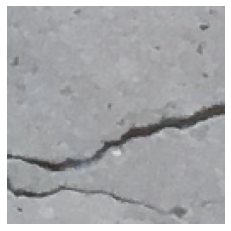

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


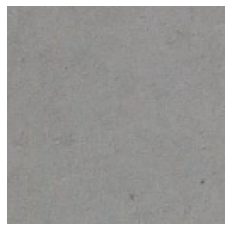

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


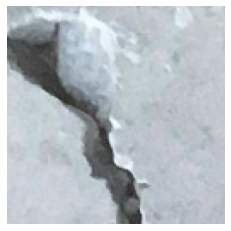

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


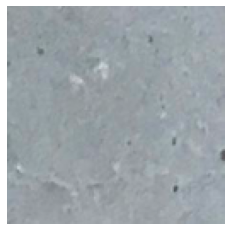

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


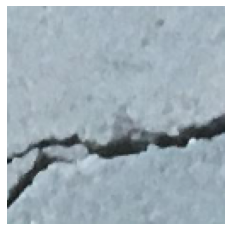

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


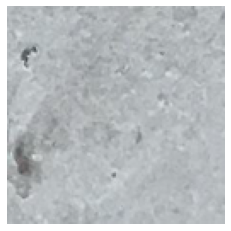

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


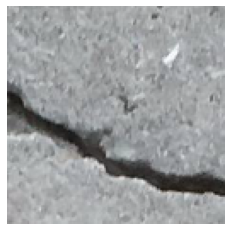

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


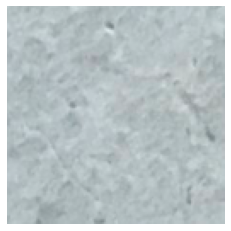

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


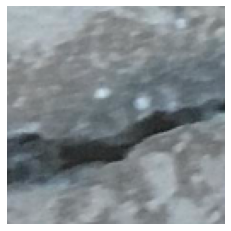

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


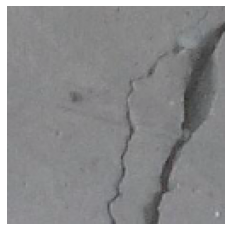

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


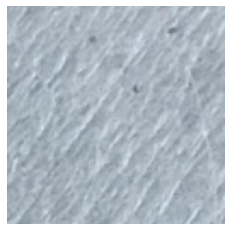

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


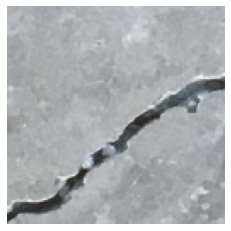

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


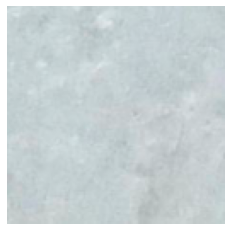

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


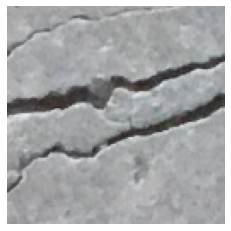

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


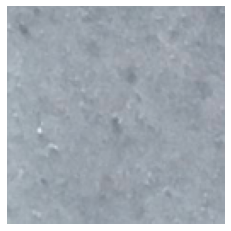

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


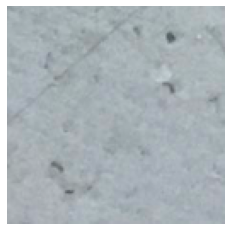

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


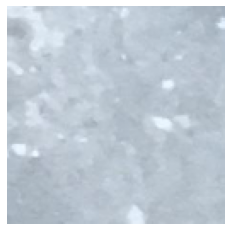

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


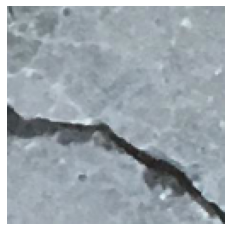

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


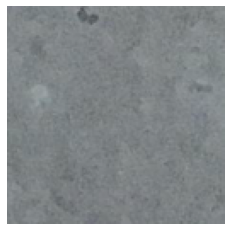

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


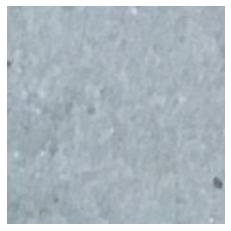

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


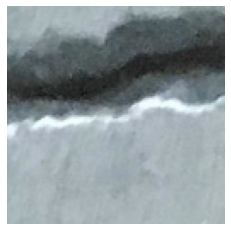

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


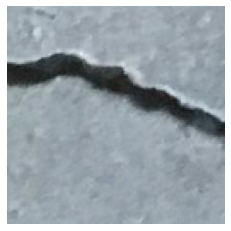

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


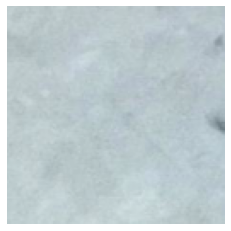

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


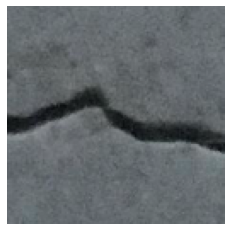

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


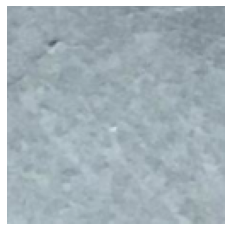

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


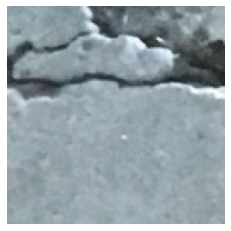

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


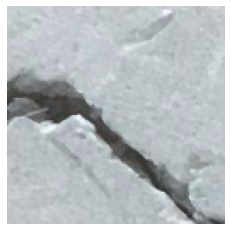

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


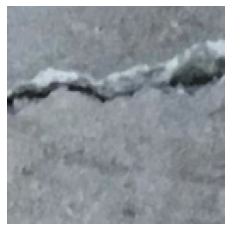

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


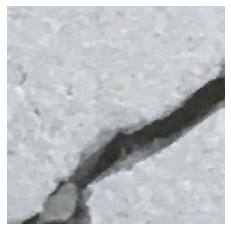

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


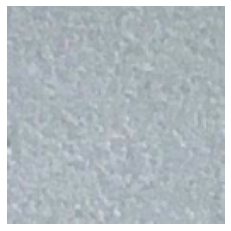

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


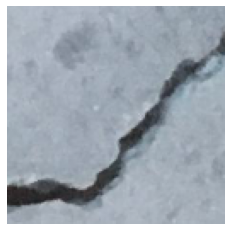

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


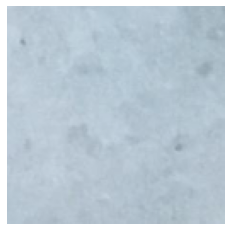

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


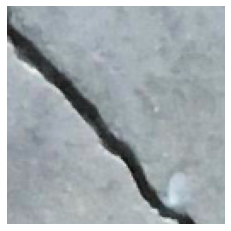

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


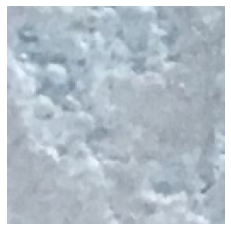

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


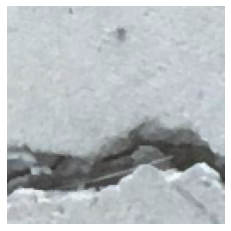

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


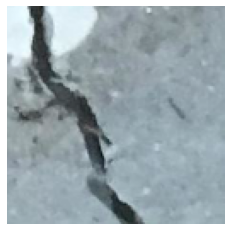

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


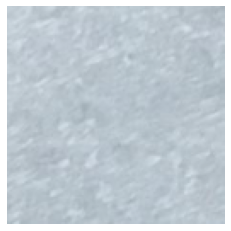

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


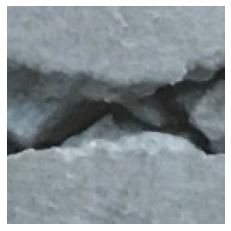

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


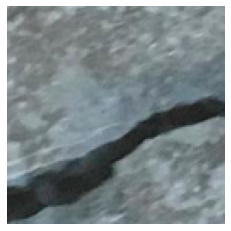

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


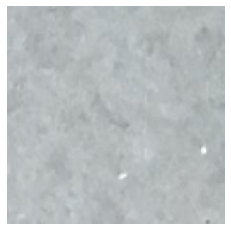

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


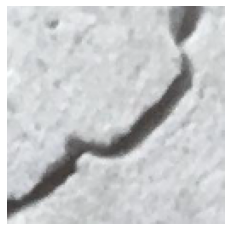

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


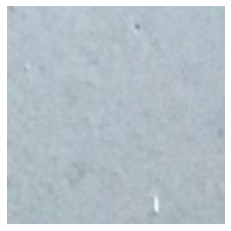

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


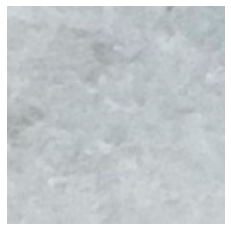

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


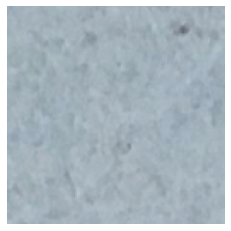

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


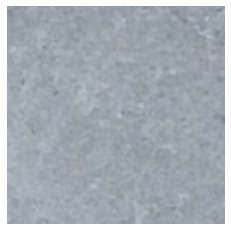

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


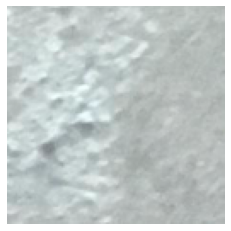

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


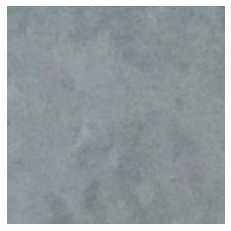

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


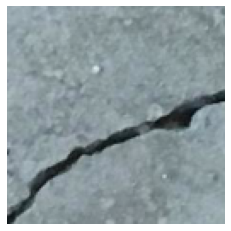

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


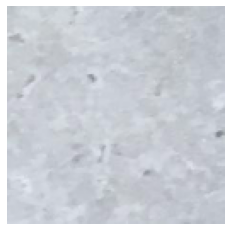

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


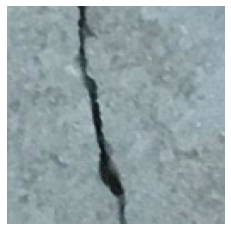

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


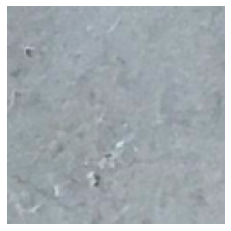

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


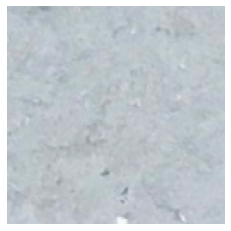

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


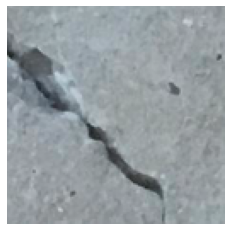

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


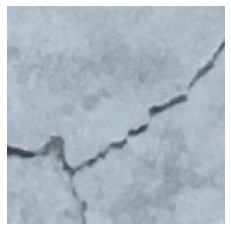

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


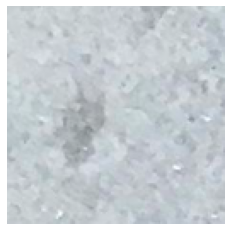

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


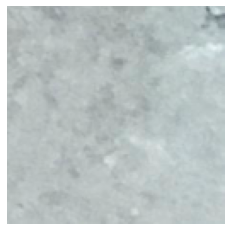

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


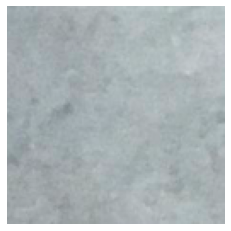

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


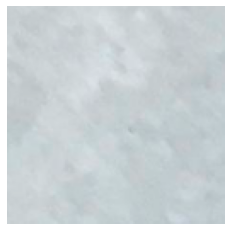

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


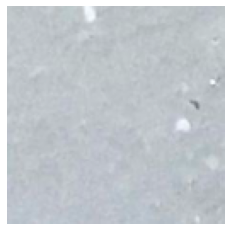

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


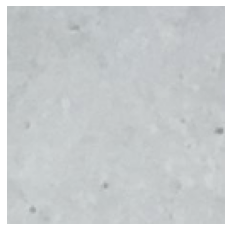

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


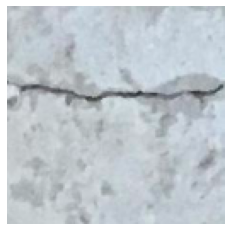

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


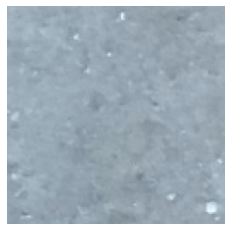

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


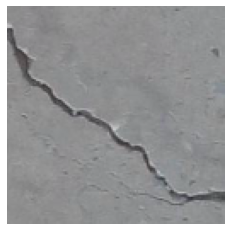

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


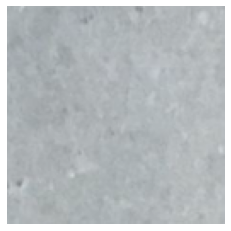

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


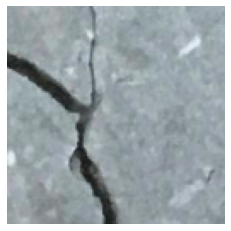

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


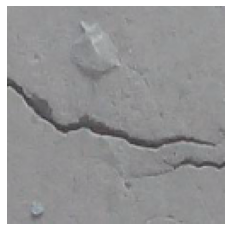

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


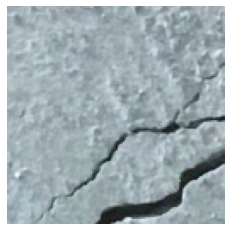

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


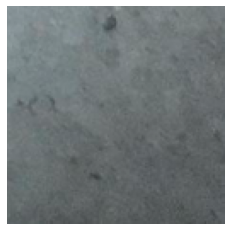

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


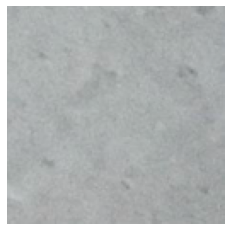

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


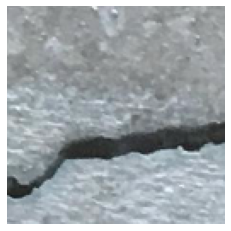

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


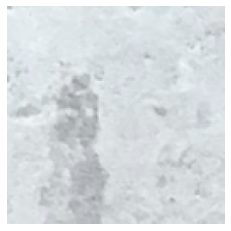

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


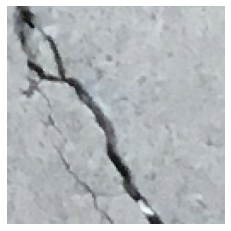

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


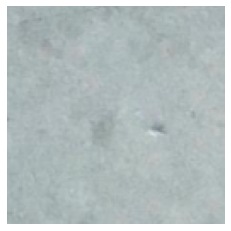

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


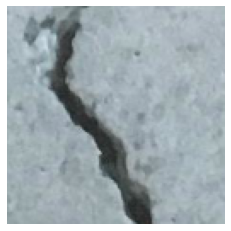

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


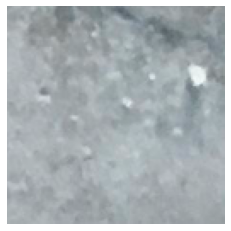

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


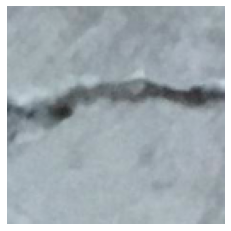

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


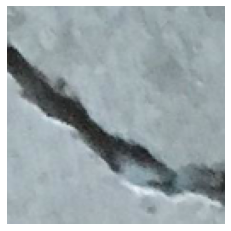

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


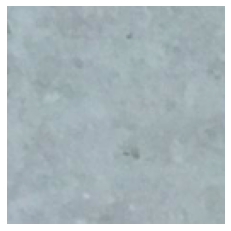

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


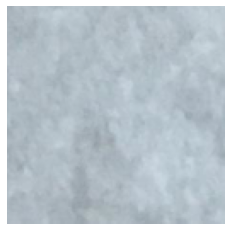

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


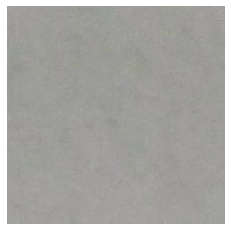

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


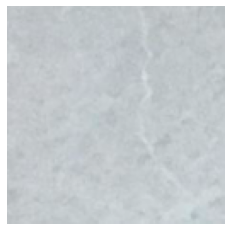

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


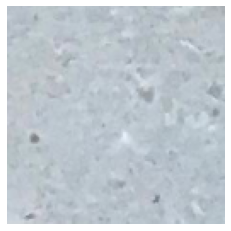

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


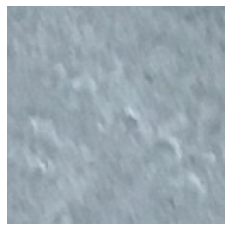

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


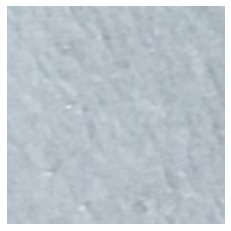

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


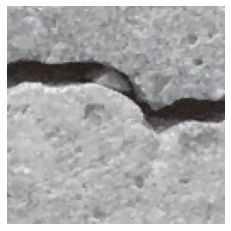

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


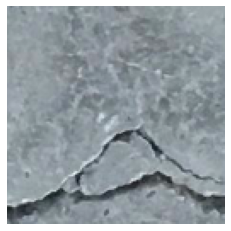

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


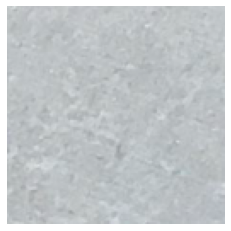

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


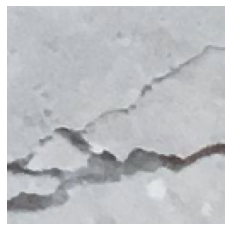

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


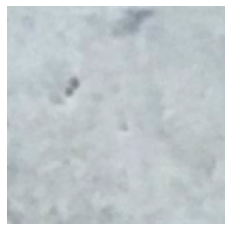

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


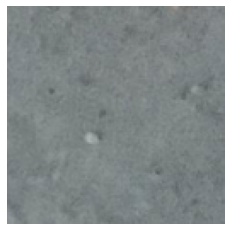

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


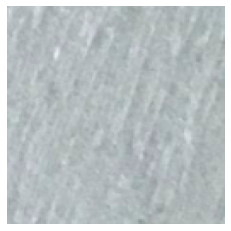

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


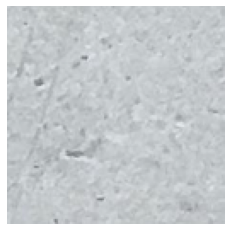

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


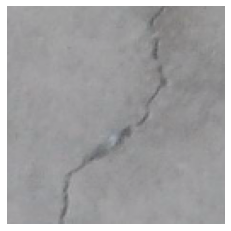

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


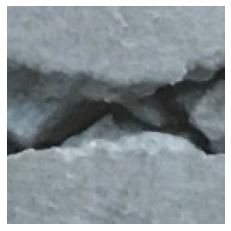

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


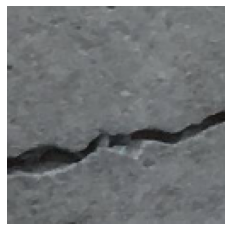

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


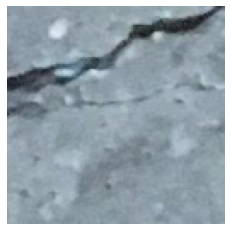

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


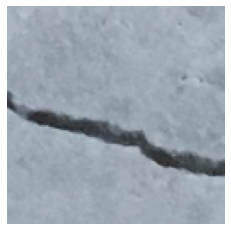

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


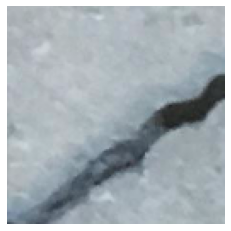

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


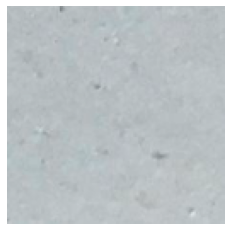

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


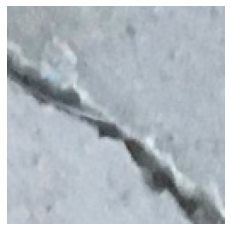

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


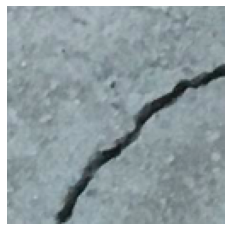

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


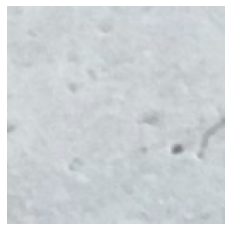

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


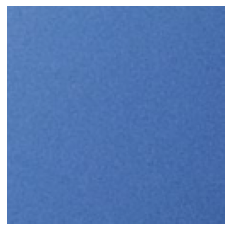

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


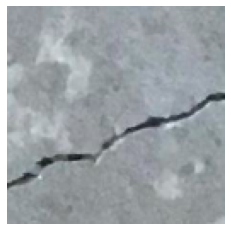

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


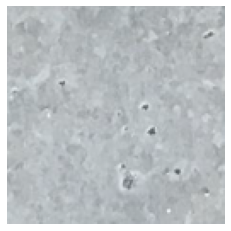

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


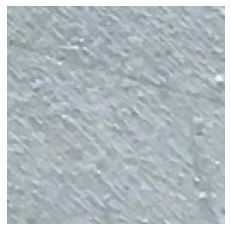

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


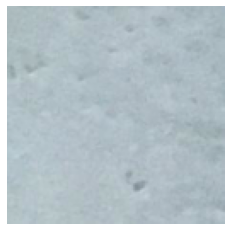

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


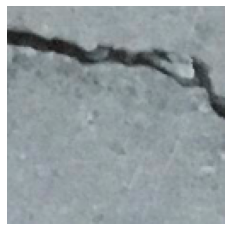

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


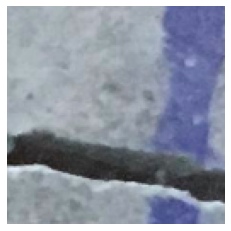

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


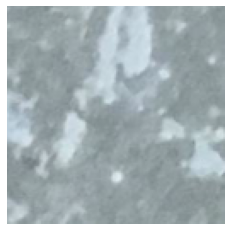

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


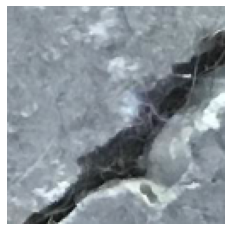

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


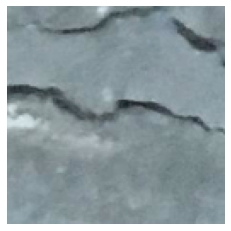

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


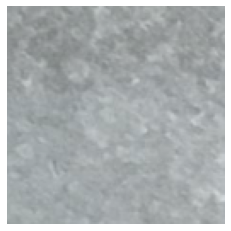

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


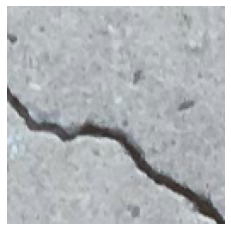

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


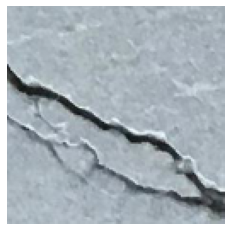

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


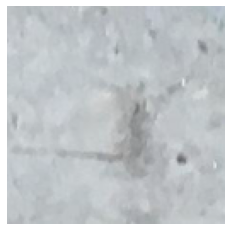

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


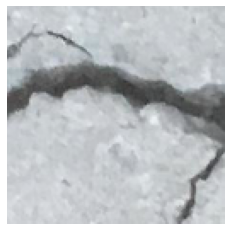

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


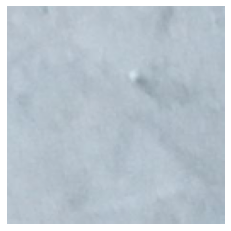

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


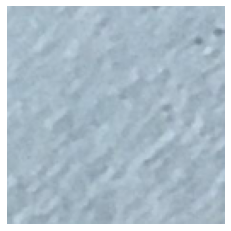

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


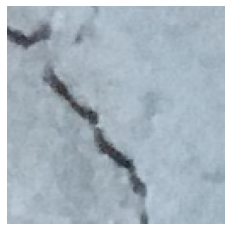

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


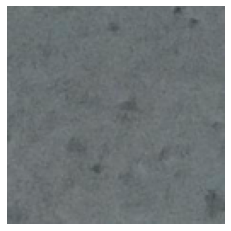

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


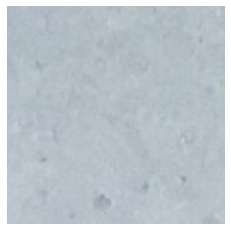

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


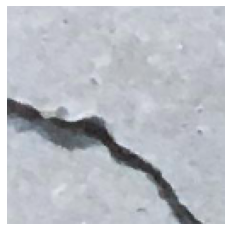

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


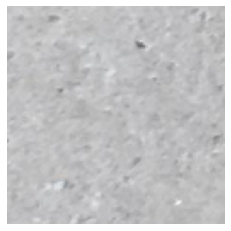

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


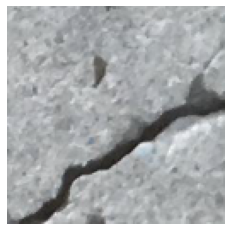

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


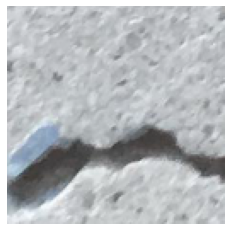

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


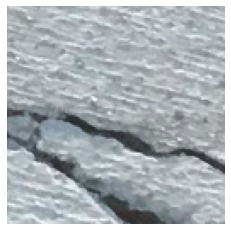

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


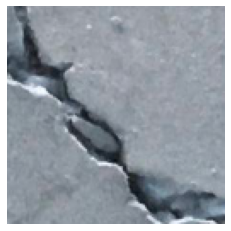

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


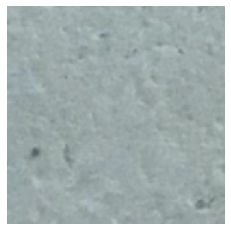

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


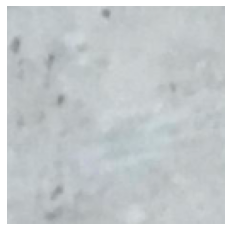

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


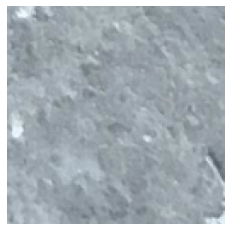

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


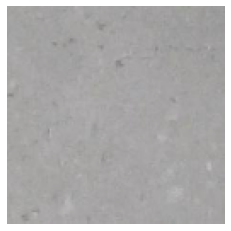

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


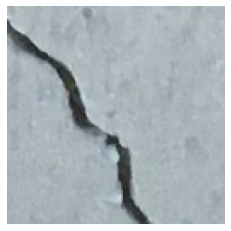

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


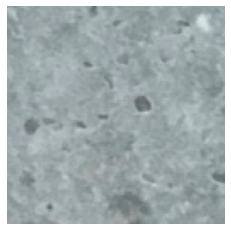

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


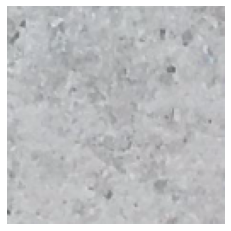

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


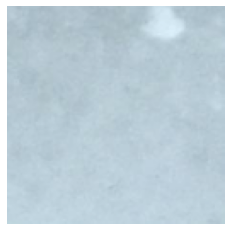

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


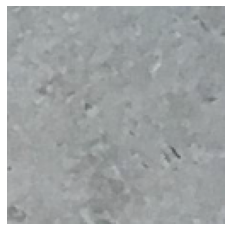

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


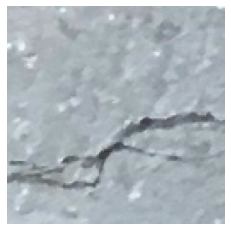

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


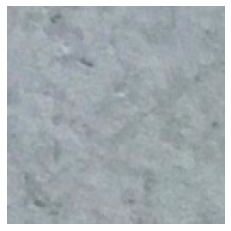

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


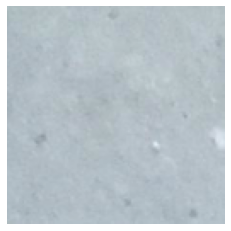

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


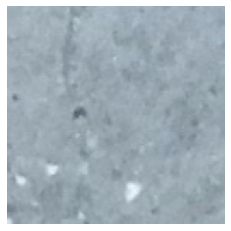

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


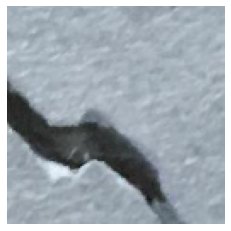

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


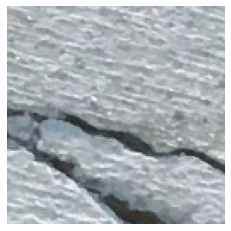

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


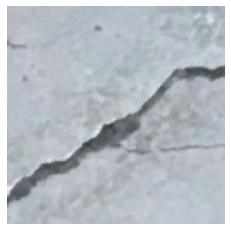

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


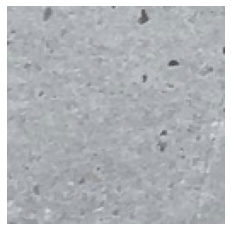

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


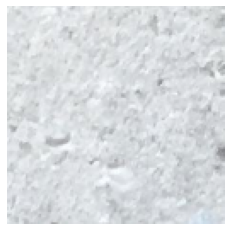

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


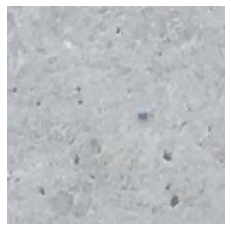

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


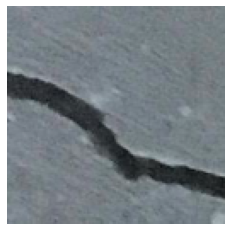

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


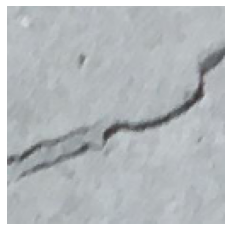

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


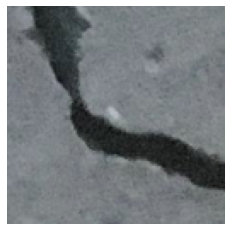

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


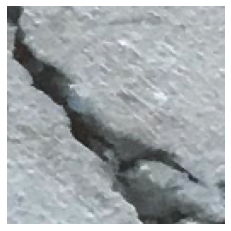

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


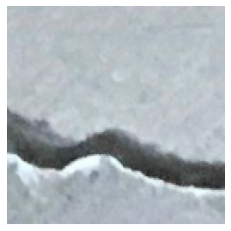

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


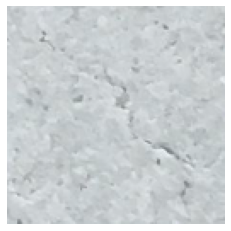

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


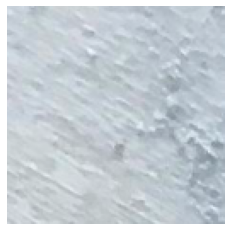

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


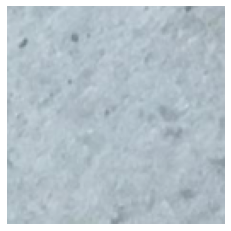

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


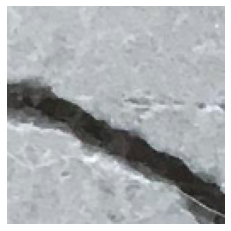

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


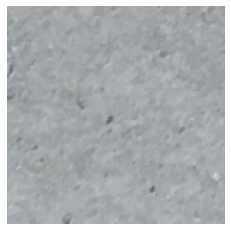

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


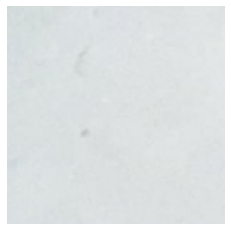

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


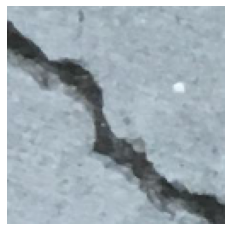

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


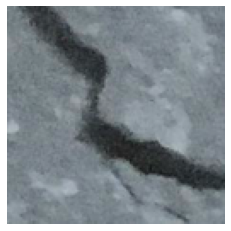

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


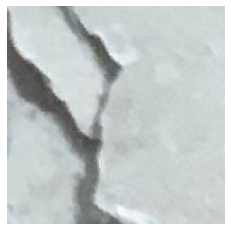

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


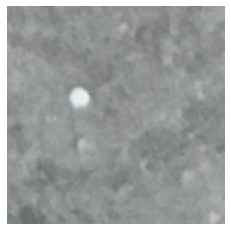

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


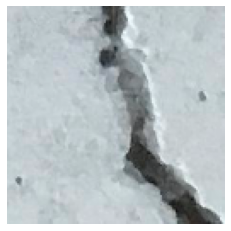

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


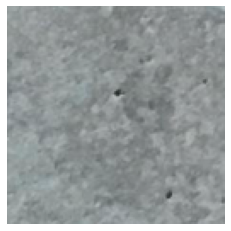

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


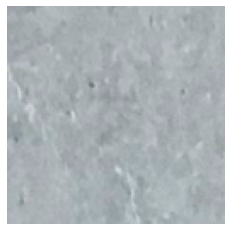

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


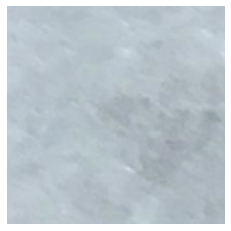

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


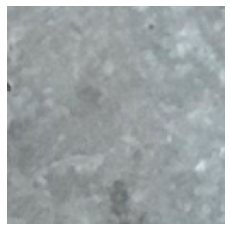

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


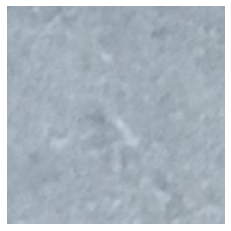

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


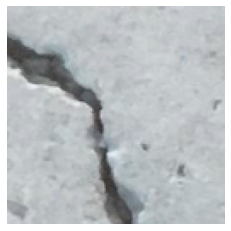

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


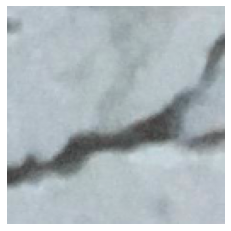

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


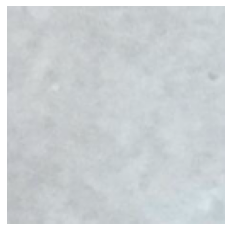

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


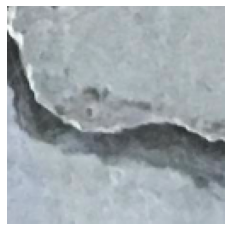

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


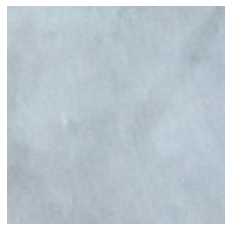

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


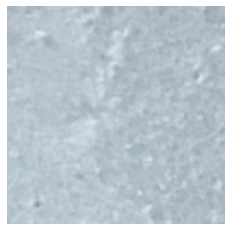

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


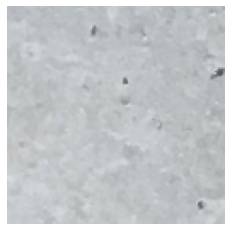

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


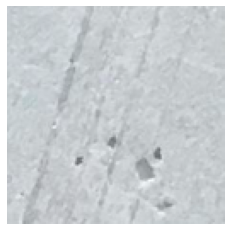

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


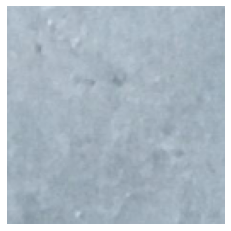

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


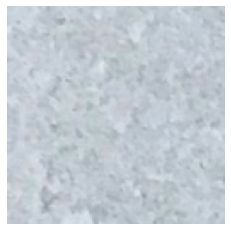

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


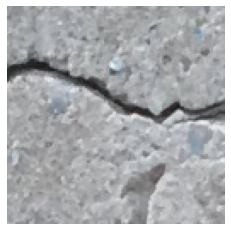

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


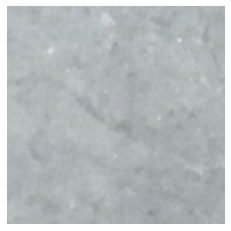

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


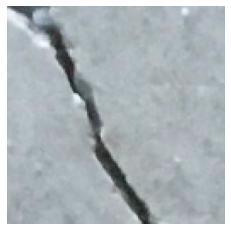

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


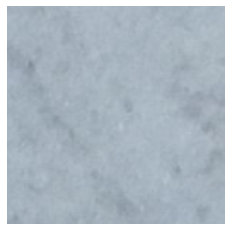

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


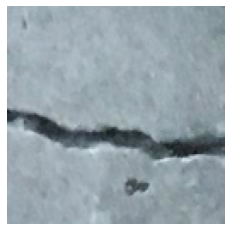

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


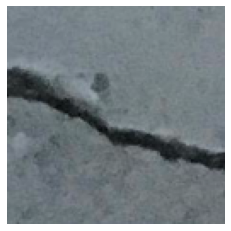

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


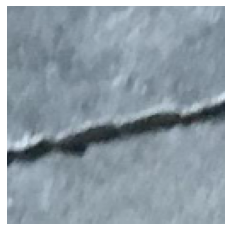

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


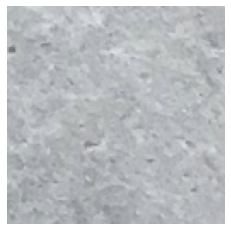

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


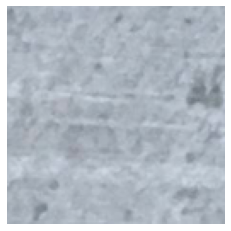

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


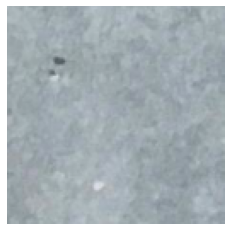

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


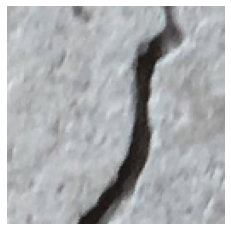

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


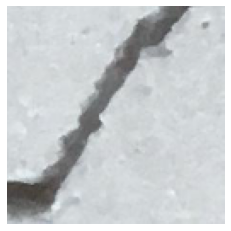

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


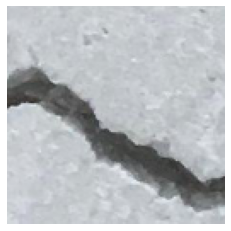

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


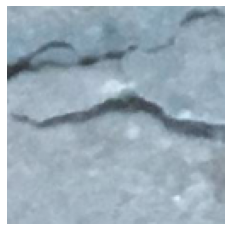

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


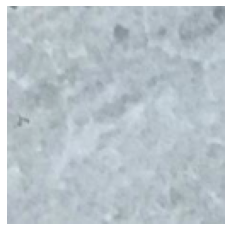

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


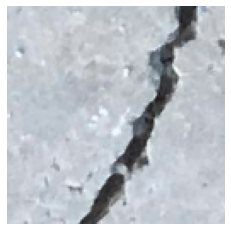

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


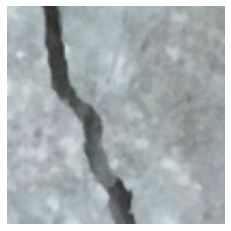

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


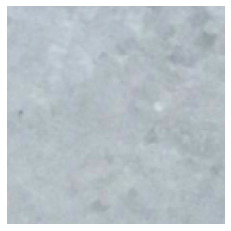

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


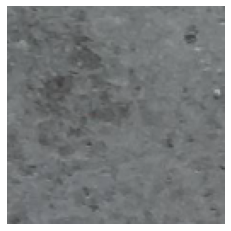

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


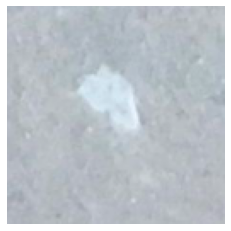

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


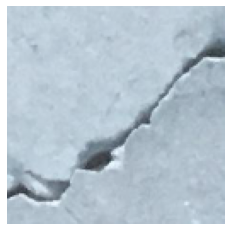

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


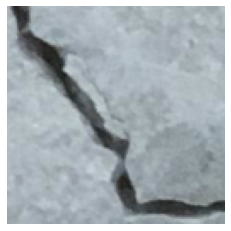

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


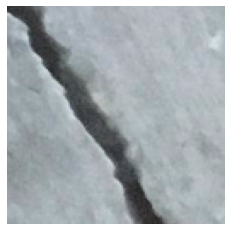

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


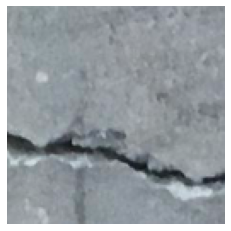

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


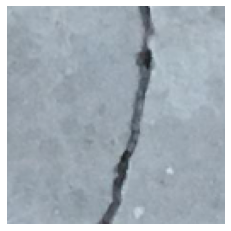

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


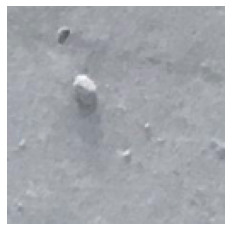

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


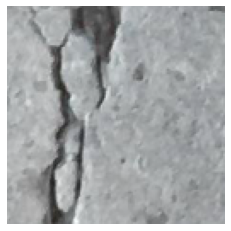

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


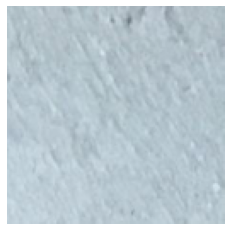

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


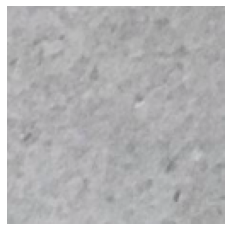

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


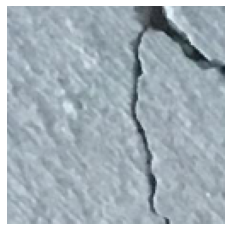

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


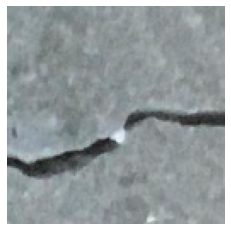

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


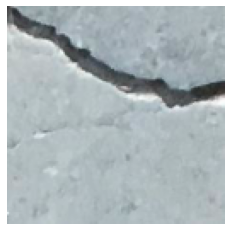

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


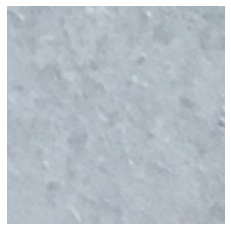

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


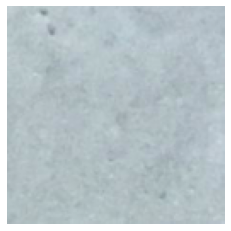

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


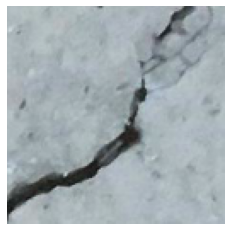

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


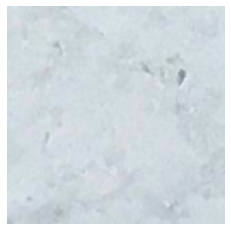

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


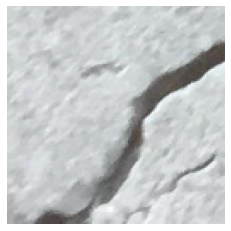

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


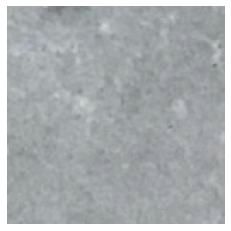

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


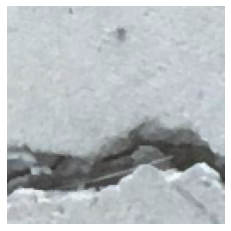

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


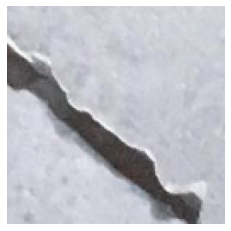

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


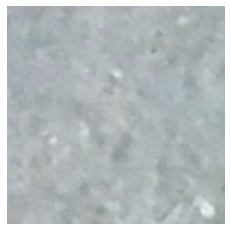

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


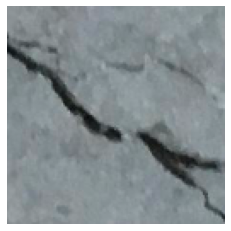

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


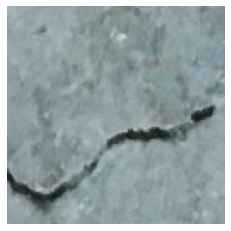

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


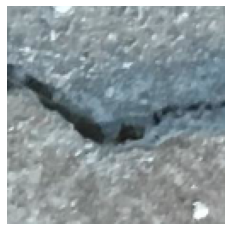

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


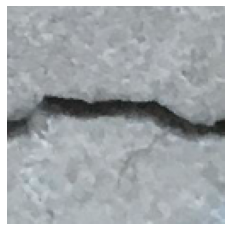

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


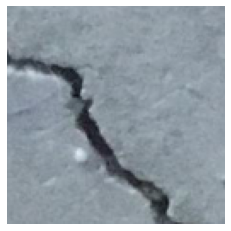

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


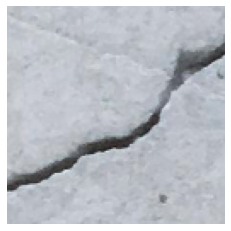

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


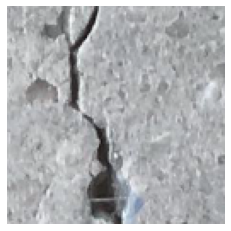

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


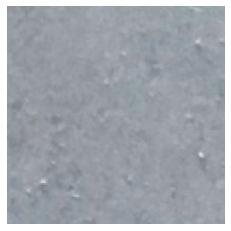

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


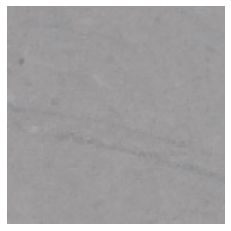

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


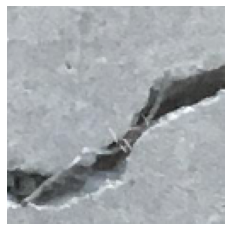

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


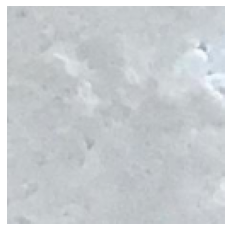

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


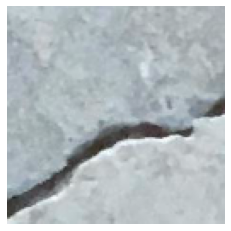

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


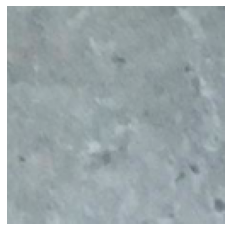

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


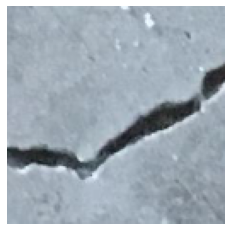

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


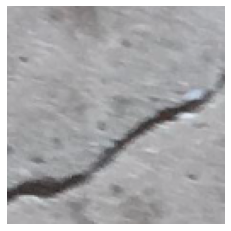

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


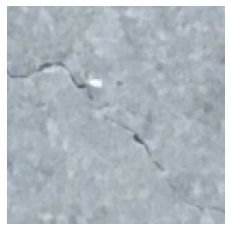

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


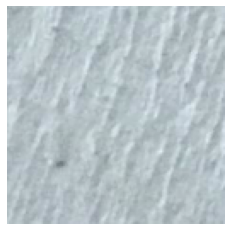

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


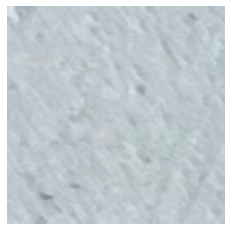

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


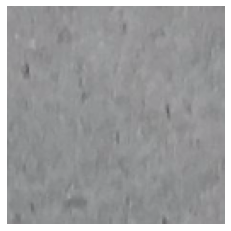

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


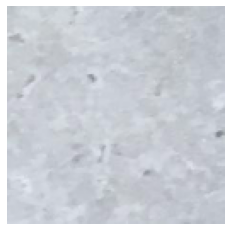

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


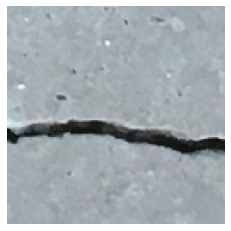

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


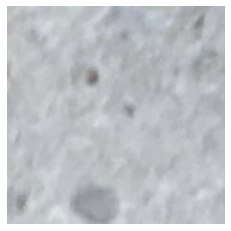

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


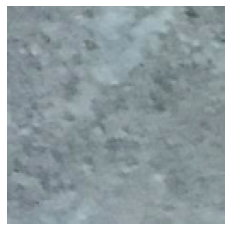

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


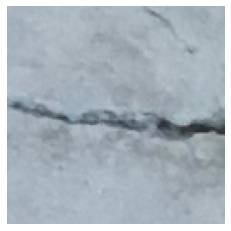

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


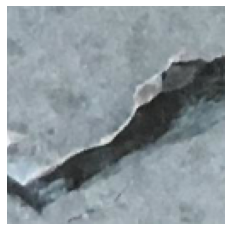

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


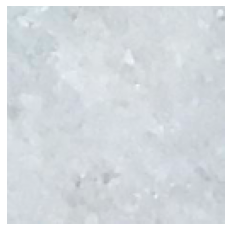

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


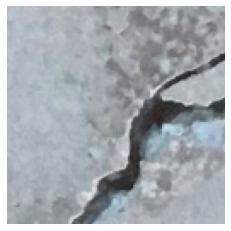

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


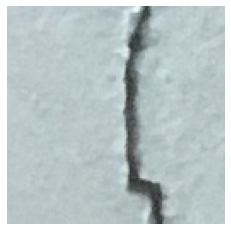

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


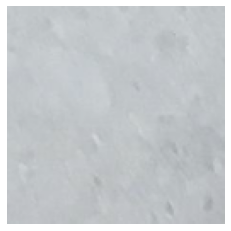

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


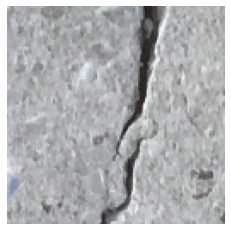

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


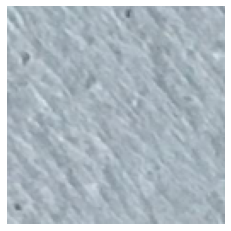

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


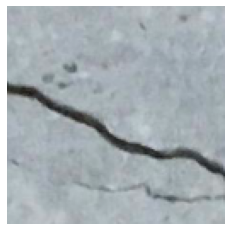

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


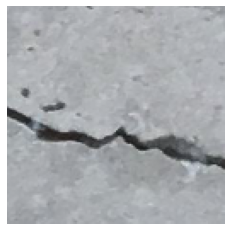

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


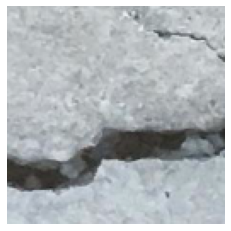

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


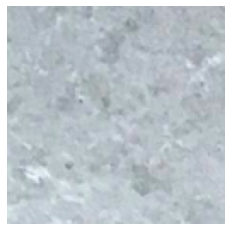

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


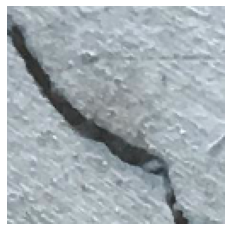

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


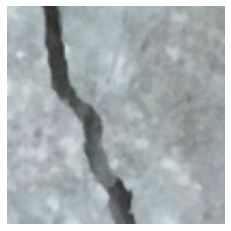

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


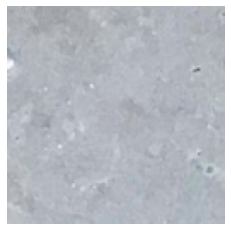

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


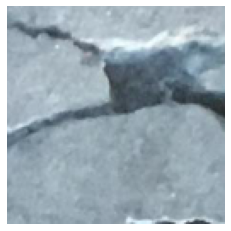

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


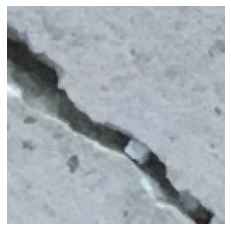

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


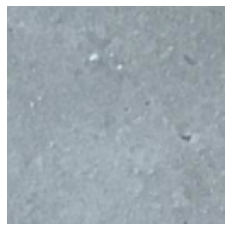

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


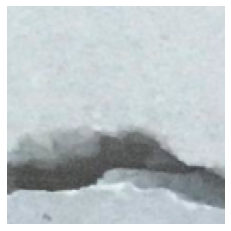

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


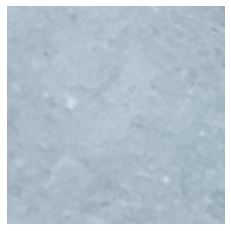

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


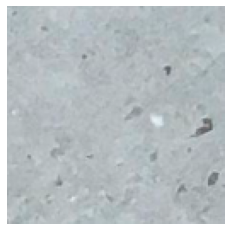

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


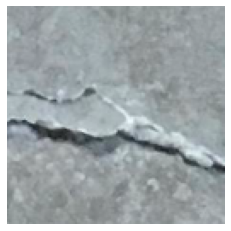

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


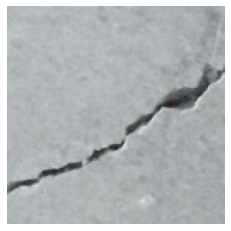

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


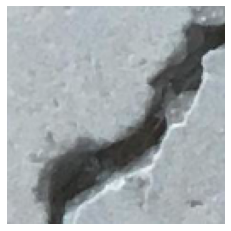

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


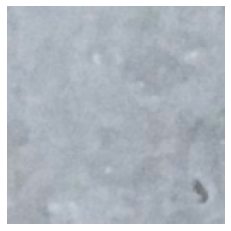

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


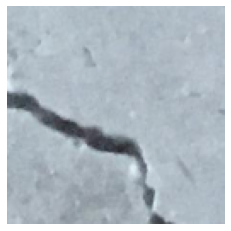

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


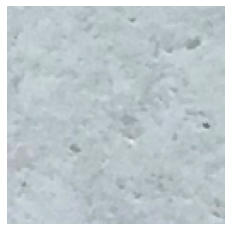

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


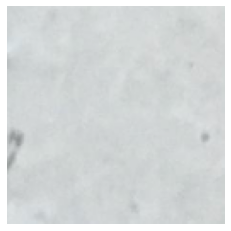

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


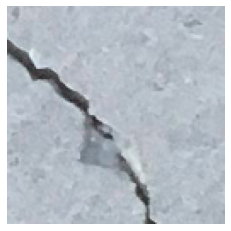

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


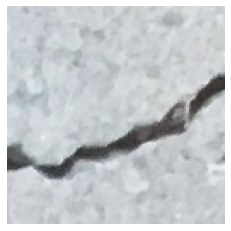

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


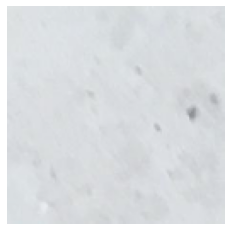

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


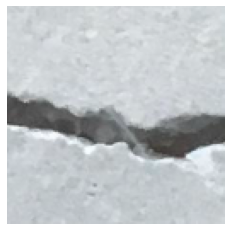

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


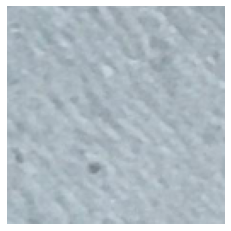

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


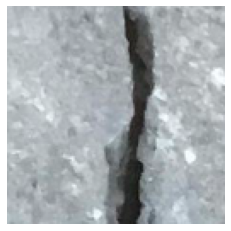

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


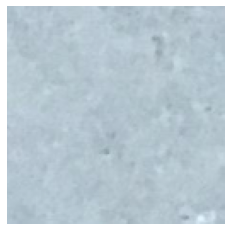

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


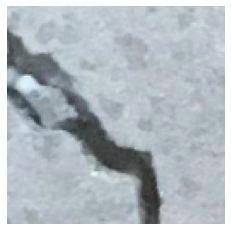

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


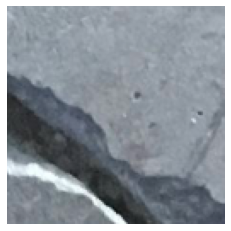

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


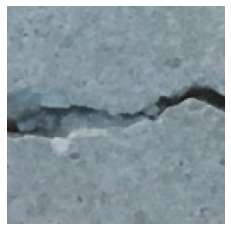

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


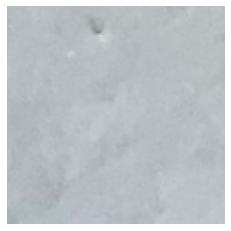

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


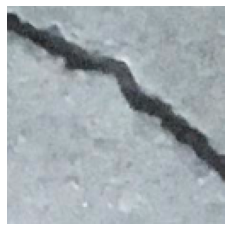

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


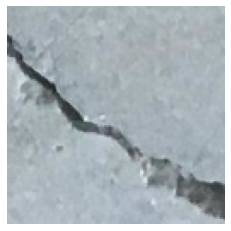

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


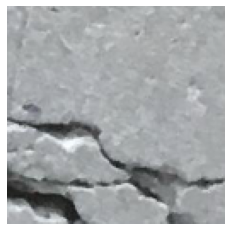

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


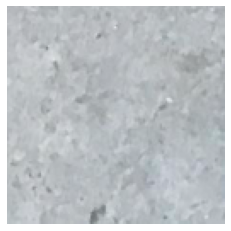

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


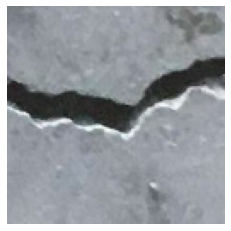

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


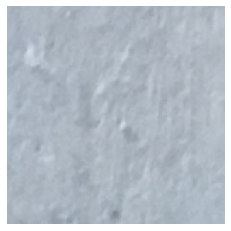

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


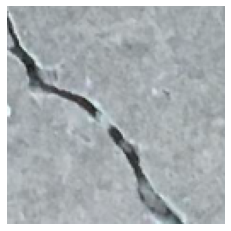

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


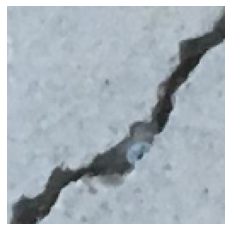

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


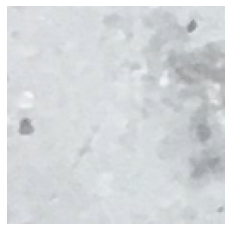

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


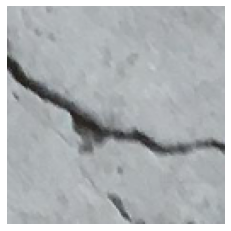

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


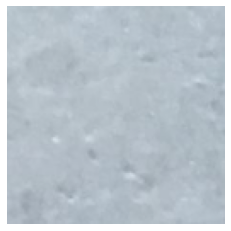

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


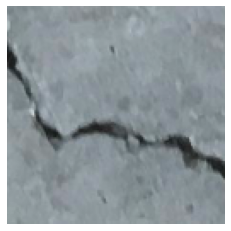

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


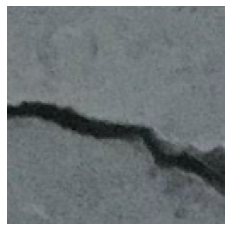

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


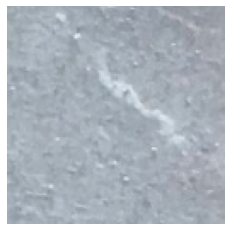

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


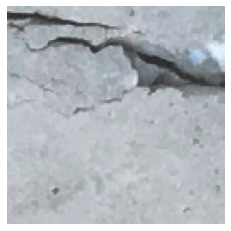

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


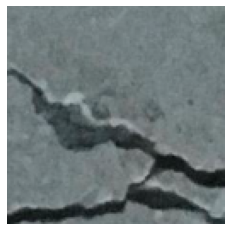

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


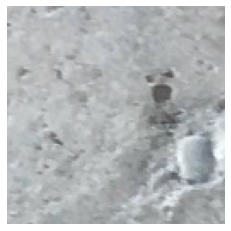

Ground truth class:  \Sin_Grietas
Predicted class:  \Con_Grietas
Wrong prediction#####################################################


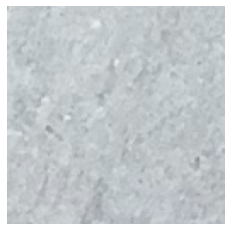

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


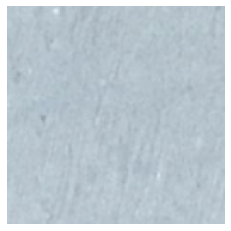

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


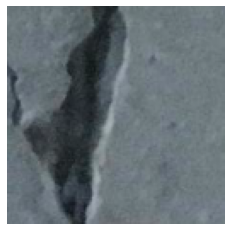

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


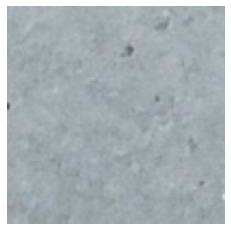

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


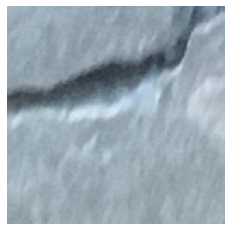

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


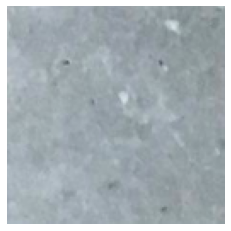

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


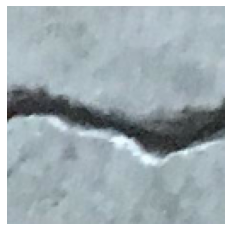

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


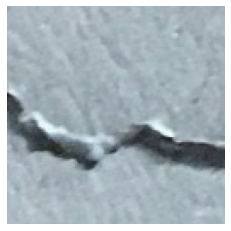

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


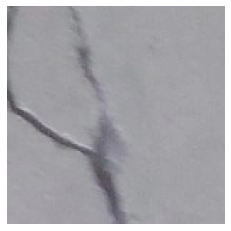

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


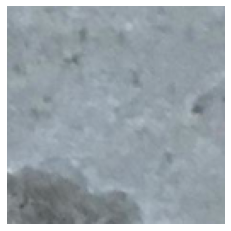

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


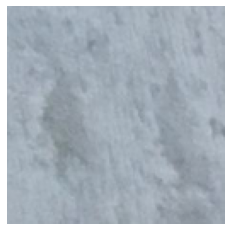

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


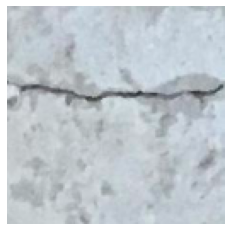

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


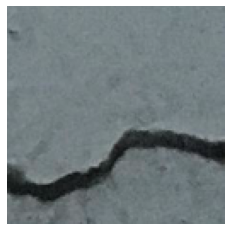

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


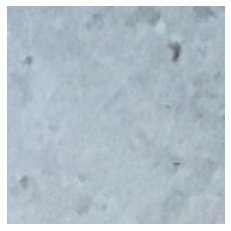

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


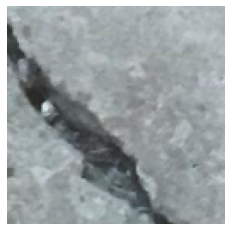

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


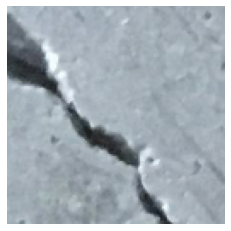

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


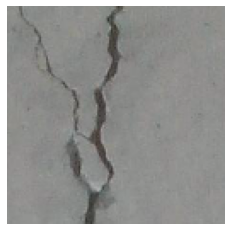

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


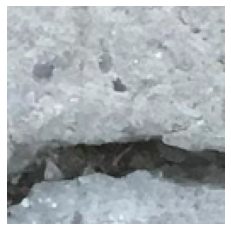

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


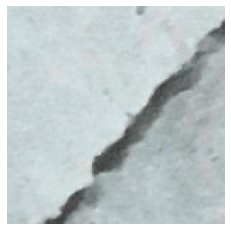

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


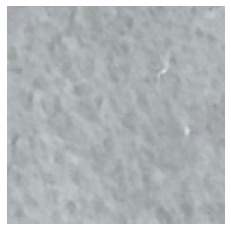

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


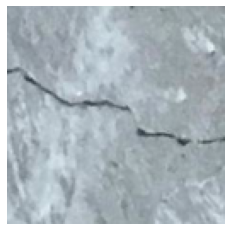

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


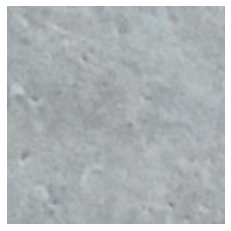

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


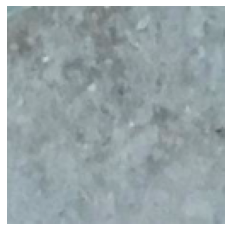

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


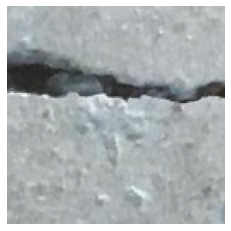

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


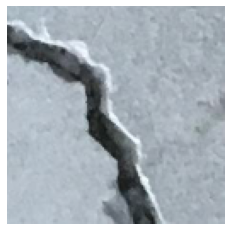

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


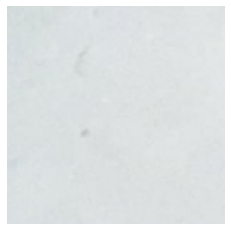

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


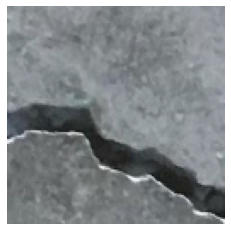

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


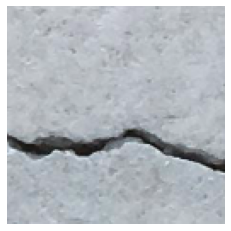

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


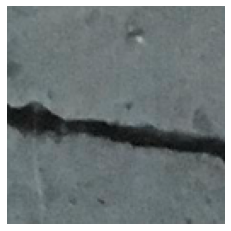

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


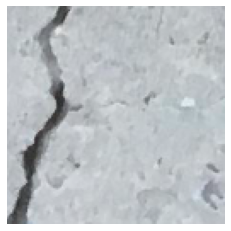

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


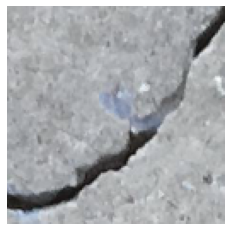

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


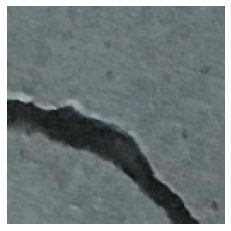

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


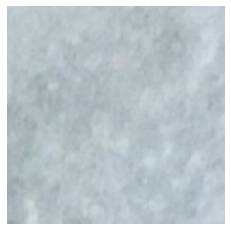

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


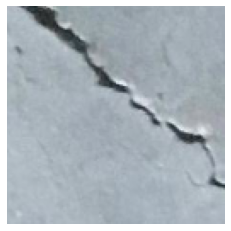

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


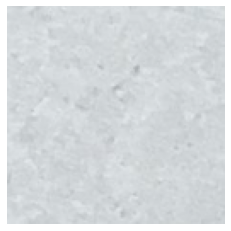

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


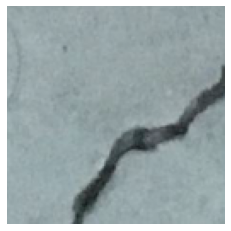

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


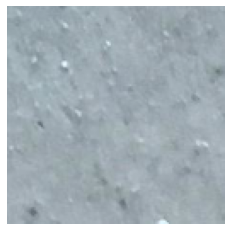

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


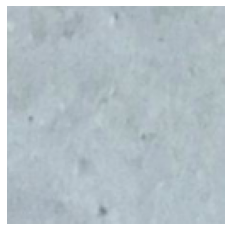

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


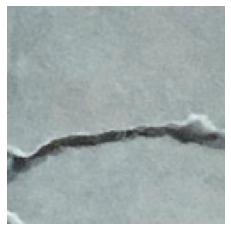

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


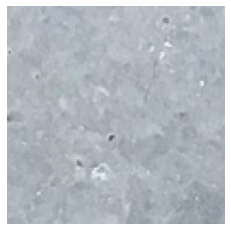

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


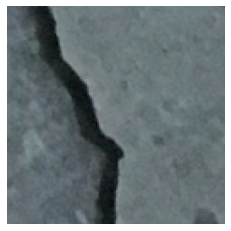

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


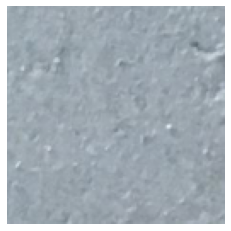

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


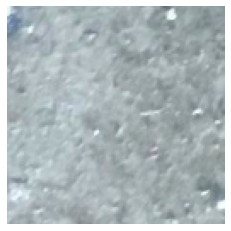

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


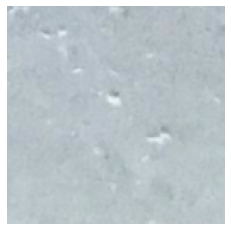

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


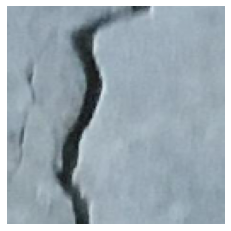

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


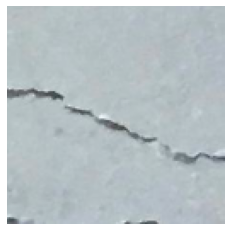

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


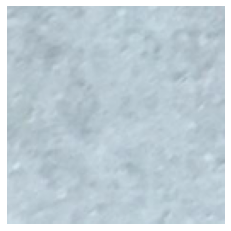

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


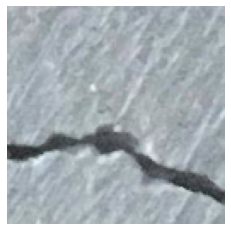

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


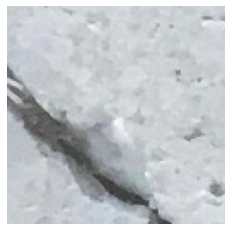

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


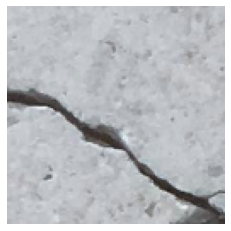

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


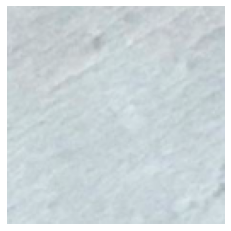

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


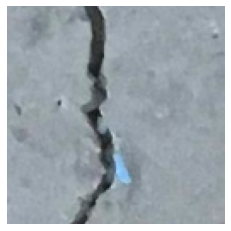

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


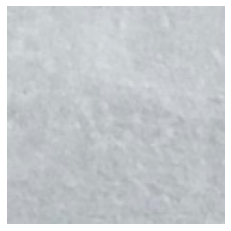

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


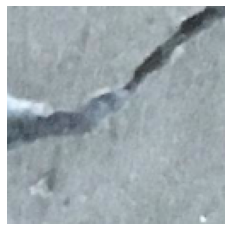

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


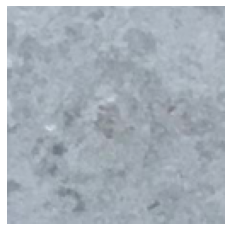

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


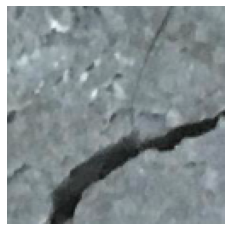

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


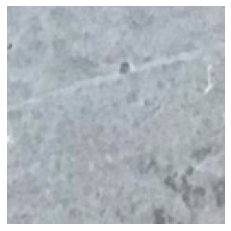

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


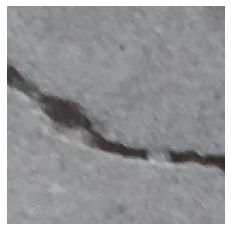

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


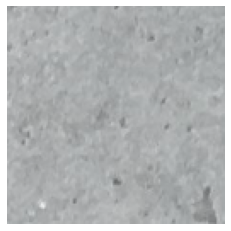

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


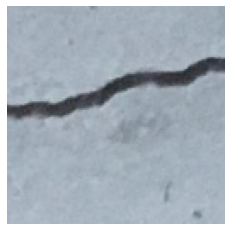

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


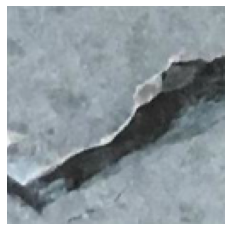

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


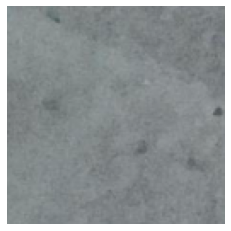

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


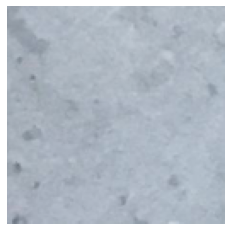

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


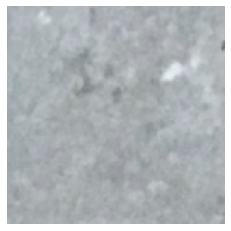

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


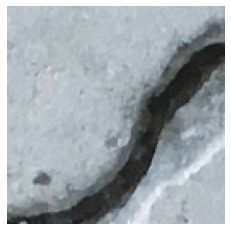

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


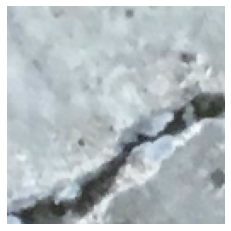

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


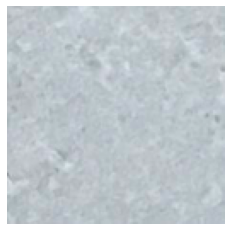

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


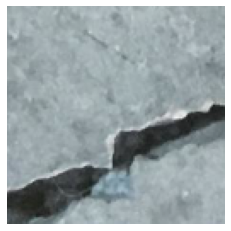

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


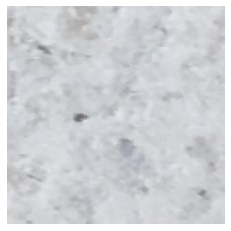

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


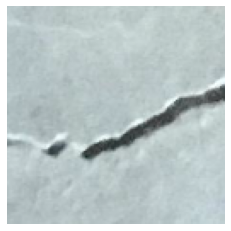

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


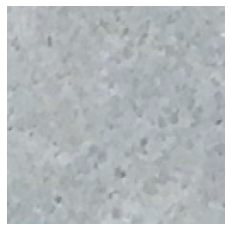

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


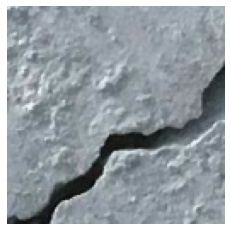

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


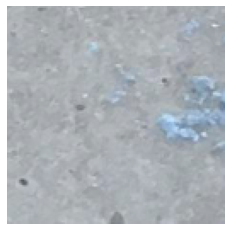

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


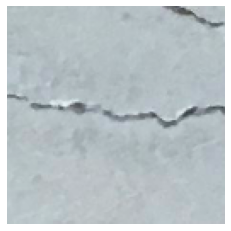

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


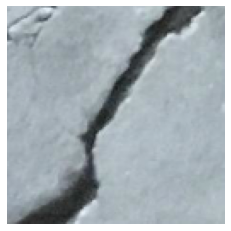

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


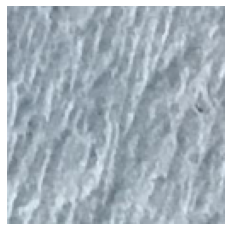

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


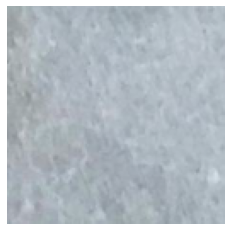

Ground truth class:  \Sin_Grietas
Predicted class:  \Sin_Grietas


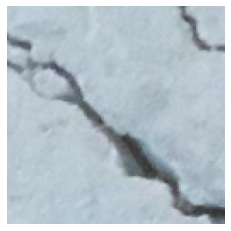

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


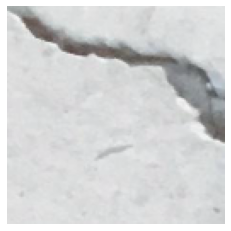

Ground truth class:  \Con_Grietas
Predicted class:  \Con_Grietas


In [ ]:
for _ in range(499):
    rand_pos = random.randint(0, len(testX) - 1)
    rand_img = testX[rand_pos]
    
    # Mostrar la imagen con matplotlib
    plt.imshow(rand_img)  
    plt.axis('off')  # Ocultar los ejes
    plt.show()
    
    # Mostrar la clase real y predicha
    print('Ground truth class: ', lb.classes_[testY[rand_pos]])
    print('Predicted class: ', lb.classes_[predictions[rand_pos][0]])

    # Verificar si la predicción fue incorrecta
    if testY[rand_pos] != predictions[rand_pos][0]:
        print('Wrong prediction#####################################################')